<a href="https://colab.research.google.com/github/egemenpamukcu/Content-Analysis-Final-Project/blob/main/deep-text-analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import warnings
warnings.filterwarnings('ignore')
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Genre Classification with BERT
## Model Training

In [2]:
from collections import Counter
import numpy as np
import pandas as pd
wiki = pd.read_csv('/content/drive/MyDrive/deep-learning/movies.csv')
wiki = wiki[~wiki['Genre'].isna()]

wiki['Genre'] = wiki['Genre'].apply(lambda x: x.split('|'))
genres = wiki['Genre'].sum()
genres = Counter(genres)
genres = [k for k, v in genres.items() if v > 900] + ['Western']
genres = dict(zip(genres, range(len(genres))))

one_hot_genres = []
for genre_list in wiki['Genre']: 
    one_hot_genre = np.zeros(len(genres))
    for genre in genre_list: 
        try:
            one_hot_genre[genres[genre]] = 1
        except KeyError: 
            continue
    one_hot_genres.append(one_hot_genre)

one_hot_genres = np.array(one_hot_genres)

In [3]:
# Create sentence and label lists
sentences = wiki['plot'].values

# We need to add special tokens at the beginning and end of each sentence for BERT to work properly
sentences = ["[CLS] " + sentence + " [SEP]" for sentence in sentences]
labels = one_hot_genres

In [ ]:
# !pip install transformers

In [5]:
from transformers import BertTokenizer

MAX_LEN = 350

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True, truncation=True, model_max_length=MAX_LEN)

tokenized_texts = [tokenizer.tokenize(sent)[:MAX_LEN - 1] + ['[SEP]'] for sent in sentences]
print("Tokenize the first plot:")
print(tokenized_texts[1])

Tokenize the first plot:
['[CLS]', 'a', 'series', 'of', 'murders', 'of', 'rich', 'young', 'women', 'throughout', 'arizona', 'bear', 'distinctive', 'signatures', 'of', 'a', 'serial', 'killer', '.', 'clues', 'lead', 'detective', 'charles', 'mendoza', 'to', 'visit', 'paul', 'white', ',', 'a', 'sound', 'expert', 'installing', 'hi', '-', 'fi', 'systems', 'in', 'wealthy', 'people', "'", 's', 'homes', '.', 'his', 'special', 'talent', 'is', 'to', 'make', 'a', 'noise', 'which', 'echoes', 'through', 'the', 'air', 'ca', '##vi', '##ties', 'in', 'his', 'head', 'and', 'shows', 'him', 'where', 'the', 'sound', 'of', 'the', 'speakers', 'should', 'come', 'from', 'and', 'echo', 'in', 'the', 'room', '.', 'he', 'is', 'married', 'to', 'joan', ',', 'whom', ',', 'ten', 'years', 'earlier', ',', 'he', 'had', 'seduce', '##d', 'away', 'from', 'mike', 'des', '##anto', '##s', ',', 'her', 'then', 'current', 'boyfriend', '.', 'joan', 'is', 'questioned', 'by', 'mendoza', ',', 'but', 'does', 'not', 'believe', 'his', 'i

In [6]:
input_ids = [tokenizer.convert_tokens_to_ids(x) for x in tokenized_texts]

In [7]:
import os
os.environ['KERAS_BACKEND'] = 'tensorflow'
from keras.preprocessing.sequence import pad_sequences

In [8]:
# Pad our input tokens
input_ids = pad_sequences(input_ids, maxlen=MAX_LEN, dtype="long", truncating="post", padding="post")

In [9]:
# Create attention masks
attention_masks = []

# Create a mask of 1s for each token followed by 0s for padding
for seq in input_ids:
    seq_mask = [float(i>0) for i in seq]
    attention_masks.append(seq_mask)

In [10]:
from sklearn.model_selection import train_test_split

# Use train_test_split to split our data into train and validation sets for training
train_inputs, validation_inputs, train_labels, validation_labels = train_test_split(input_ids, labels, 
                                                            random_state=2020, test_size=0.2)
train_masks, validation_masks, _, _ = train_test_split(attention_masks, input_ids,
                                             random_state=2020, test_size=0.2)

In [11]:
import torch

# Convert all of our data into torch tensors, the required datatype for our model

train_inputs = torch.tensor(train_inputs)
validation_inputs = torch.tensor(validation_inputs)
train_labels = torch.tensor(train_labels)
validation_labels = torch.tensor(validation_labels)
train_masks = torch.tensor(train_masks)
validation_masks = torch.tensor(validation_masks)

In [12]:
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
from transformers import BertTokenizer, BertConfig
from transformers import AdamW, BertForSequenceClassification
from tqdm import tqdm, trange
import io

# Select a batch size for training. For fine-tuning BERT on a specific task, the authors recommend a batch size of 16 or 32
batch_size = 32

# Create an iterator of our data with torch DataLoader. This helps save on memory during training because, unlike a for loop, 
# with an iterator the entire dataset does not need to be loaded into memory

train_data = TensorDataset(train_inputs, train_masks, train_labels)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

validation_data = TensorDataset(validation_inputs, validation_masks, validation_labels)
validation_sampler = SequentialSampler(validation_data)
validation_dataloader = DataLoader(validation_data, sampler=validation_sampler, batch_size=batch_size)

In [13]:
output_dim = len(genres)
model = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=output_dim).cuda()

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

In [14]:
param_optimizer = list(model.named_parameters())
no_decay = ['bias', 'gamma', 'beta']
optimizer_grouped_parameters = [
    {'params': [p for n, p in param_optimizer if not any(nd in n for nd in no_decay)],
     'weight_decay_rate': 0.01},
    {'params': [p for n, p in param_optimizer if any(nd in n for nd in no_decay)],
     'weight_decay_rate': 0.0}
]

In [15]:
# This variable contains all of the hyperparemeter information our training loop needs
optimizer = AdamW(model.parameters(),
                  lr = 2e-5, # args.learning_rate - default is 5e-5, our notebook had 2e-5
                  eps = 1e-8 # args.adam_epsilon  - default is 1e-8.
                )

In [16]:
from transformers import get_linear_schedule_with_warmup

# Number of training epochs (authors recommend between 2 and 4)
epochs = 4

# Total number of training steps is number of batches * number of epochs.
total_steps = len(train_dataloader) * epochs

# Create the learning rate scheduler.
scheduler = get_linear_schedule_with_warmup(optimizer, 
                                            num_warmup_steps = 0, # Default value in run_glue.py
                                            num_training_steps = total_steps)

In [17]:
import time
import datetime
from sklearn.metrics import roc_auc_score

# Function to calculate the accuracy of our predictions vs labels
def flat_accuracy(preds, labels):
    pred_labels = (preds > .5).astype(int)
    mean_accuracy = (labels == pred_labels).mean(axis = 0).mean()
    return mean_accuracy

def format_time(elapsed):
    '''
    Takes a time in seconds and returns a string hh:mm:ss
    '''
    # Round to the nearest second.
    elapsed_rounded = int(round((elapsed)))
    
    # Format as hh:mm:ss
    return str(datetime.timedelta(seconds=elapsed_rounded))

In [18]:
import random

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# This training code is based on the `run_glue.py` script here:
# https://github.com/huggingface/transformers/blob/5bfcd0485ece086ebcbed2d008813037968a9e58/examples/run_glue.py#L128

# Set the seed value all over the place to make this reproducible.
seed_val = 42

random.seed(seed_val)
np.random.seed(seed_val)
torch.manual_seed(seed_val)
torch.cuda.manual_seed_all(seed_val)

# Store the average loss after each epoch so we can plot them.
loss_values = []

# For each epoch...
for epoch_i in range(0, epochs):
    
    # ========================================
    #               Training
    # ========================================
    
    # Perform one full pass over the training set.

    print("")
    print('======== Epoch {:} / {:} ========'.format(epoch_i + 1, epochs))
    print('Training...')

    # Measure how long the training epoch takes.
    t0 = time.time()

    # Reset the total loss for this epoch.
    total_loss = 0

    # Put the model into training mode. Don't be mislead--the call to 
    # `train` just changes the *mode*, it doesn't *perform* the training.
    # `dropout` and `batchnorm` layers behave differently during training
    # vs. test (source: https://stackoverflow.com/questions/51433378/what-does-model-train-do-in-pytorch)
    model.train()

    # For each batch of training data...
    for step, batch in enumerate(train_dataloader):

        # Progress update every 40 batches.
        if step % 40 == 0 and not step == 0:
            # Calculate elapsed time in minutes.
            elapsed = format_time(time.time() - t0)
            
            # Report progress.
            print('  Batch {:>5,}  of  {:>5,}.    Elapsed: {:}.'.format(step, len(train_dataloader), elapsed))

        # Unpack this training batch from our dataloader. 
        #
        # As we unpack the batch, we'll also copy each tensor to the GPU using the 
        # `to` method.
        #
        # `batch` contains three pytorch tensors:
        #   [0]: input ids 
        #   [1]: attention masks
        #   [2]: labels 
        b_input_ids = batch[0].to(device)
        b_input_mask = batch[1].to(device)
        b_labels = batch[2].to(device)

        # Always clear any previously calculated gradients before performing a
        # backward pass. PyTorch doesn't do this automatically because 
        # accumulating the gradients is "convenient while training RNNs". 
        # (source: https://stackoverflow.com/questions/48001598/why-do-we-need-to-call-zero-grad-in-pytorch)
        model.zero_grad()        

        # Perform a forward pass (evaluate the model on this training batch).
        # This will return the loss (rather than the model output) because we
        # have provided the `labels`.
        # The documentation for this `model` function is here: 
        # https://huggingface.co/transformers/v2.2.0/model_doc/bert.html#transformers.BertForSequenceClassification
        outputs = model(b_input_ids, 
                    token_type_ids=None, 
                    attention_mask=b_input_mask, 
                    labels=b_labels)
        
        # The call to `model` always returns a tuple, so we need to pull the 
        # loss value out of the tuple.
        loss = outputs[0]

        # Accumulate the training loss over all of the batches so that we can
        # calculate the average loss at the end. `loss` is a Tensor containing a
        # single value; the `.item()` function just returns the Python value 
        # from the tensor.
        total_loss += loss.item()

        # Perform a backward pass to calculate the gradients.
        loss.backward()

        # Clip the norm of the gradients to 1.0.
        # This is to help prevent the "exploding gradients" problem.
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)

        # Update parameters and take a step using the computed gradient.
        # The optimizer dictates the "update rule"--how the parameters are
        # modified based on their gradients, the learning rate, etc.
        optimizer.step()

        # Update the learning rate.
        scheduler.step()

    # Calculate the average loss over the training data.
    avg_train_loss = total_loss / len(train_dataloader)            
    
    # Store the loss value for plotting the learning curve.
    loss_values.append(avg_train_loss)

    print("")
    print("  Average training loss: {0:.2f}".format(avg_train_loss))
    print("  Training epcoh took: {:}".format(format_time(time.time() - t0)))
        
    # ========================================
    #               Validation
    # ========================================
    # After the completion of each training epoch, measure our performance on
    # our validation set.

    print("")
    print("Running Validation...")

    t0 = time.time()

    # Put the model in evaluation mode--the dropout layers behave differently
    # during evaluation.
    model.eval()

    # Tracking variables 
    eval_loss, eval_accuracy = 0, 0
    nb_eval_steps, nb_eval_examples = 0, 0

    # Evaluate data for one epoch
    for batch in validation_dataloader:
        
        # Add batch to GPU
        batch = tuple(t.to(device) for t in batch)
        
        # Unpack the inputs from our dataloader
        b_input_ids, b_input_mask, b_labels = batch
        
        # Telling the model not to compute or store gradients, saving memory and
        # speeding up validation
        with torch.no_grad():        

            # Forward pass, calculate logit predictions.
            # This will return the logits rather than the loss because we have
            # not provided labels.
            # token_type_ids is the same as the "segment ids", which 
            # differentiates sentence 1 and 2 in 2-sentence tasks.
            # The documentation for this `model` function is here: 
            # https://huggingface.co/transformers/v2.2.0/model_doc/bert.html#transformers.BertForSequenceClassification
            outputs = model(b_input_ids, 
                            token_type_ids=None, 
                            attention_mask=b_input_mask)
        
        # Get the "logits" output by the model. The "logits" are the output
        # values prior to applying an activation function like the softmax.
        logits = torch.sigmoid(outputs[0])

        # Move logits and labels to CPU
        logits = logits.detach().cpu().numpy()
        label_ids = b_labels.to('cpu').numpy()
        
        # Calculate the accuracy for this batch of test sentences.
        tmp_eval_accuracy = flat_accuracy(logits, label_ids)
        
        # Accumulate the total accuracy.
        eval_accuracy += tmp_eval_accuracy

        # Track the number of batches
        nb_eval_steps += 1

    # Report the final accuracy for this validation run.
    print("  Accuracy: {0:.2f}".format(eval_accuracy/nb_eval_steps))
    print("  Validation took: {:}".format(format_time(time.time() - t0)))

print("")
print("Training complete!")


======== Epoch 1 / 4 ========
Training...
  Batch    40  of    385.    Elapsed: 0:00:42.
  Batch    80  of    385.    Elapsed: 0:01:23.
  Batch   120  of    385.    Elapsed: 0:02:04.
  Batch   160  of    385.    Elapsed: 0:02:46.
  Batch   200  of    385.    Elapsed: 0:03:27.
  Batch   240  of    385.    Elapsed: 0:04:09.
  Batch   280  of    385.    Elapsed: 0:04:50.
  Batch   320  of    385.    Elapsed: 0:05:32.
  Batch   360  of    385.    Elapsed: 0:06:13.

  Average training loss: 0.34
  Training epcoh took: 0:06:39

Running Validation...
  Accuracy: 0.89
  Validation took: 0:00:32

======== Epoch 2 / 4 ========
Training...
  Batch    40  of    385.    Elapsed: 0:00:41.
  Batch    80  of    385.    Elapsed: 0:01:23.
  Batch   120  of    385.    Elapsed: 0:02:04.
  Batch   160  of    385.    Elapsed: 0:02:46.
  Batch   200  of    385.    Elapsed: 0:03:27.
  Batch   240  of    385.    Elapsed: 0:04:09.
  Batch   280  of    385.    Elapsed: 0:04:50.
  Batch   320  of    385.    Elap

## Model Performance

In [19]:
start = True
for batch in validation_dataloader:
    batch = tuple(t.to(device) for t in batch)
    b_input_ids, b_input_mask, b_labels = batch

    with torch.no_grad():        
        outputs = model(b_input_ids, 
                        token_type_ids=None, 
                        attention_mask=b_input_mask)

    # Get the "logits" output by the model. The "logits" are the output
    # values prior to applying an activation function like the softmax.
    logits = torch.sigmoid(outputs[0])

    # Move logits and labels to CPU
    logits = logits.detach().cpu().numpy()
    label_ids = b_labels.to('cpu').numpy()
    if start: 
        probs = logits 
        test_labels = label_ids
        start = False
    else:
        probs = np.concatenate((probs, logits))
        test_labels = np.concatenate((test_labels, label_ids))

In [48]:
from sklearn import metrics
# precision, recall, accuracy, f1, roc_auc
genres_i = [k for k, v in sorted(genres.items(), key=lambda x: x[1])]

metric_dict = {
    'f1_score': [],
    'precision': [],
    'recall': [],
    'accuracy': [],
    'roc_auc': []
}
for i, genre in enumerate(genres_i):
    metric_dict['f1_score'].append(metrics.f1_score(test_labels[:, i], probs[:, i] > .5))
    metric_dict['precision'].append(metrics.precision_score(test_labels[:, i], probs[:, i] > .5))
    metric_dict['recall'].append(metrics.recall_score(test_labels[:, i], probs[:, i] > .5))
    metric_dict['accuracy'].append(metrics.accuracy_score(test_labels[:, i], probs[:, i] > .5))
    metric_dict['roc_auc'].append(metrics.roc_auc_score(test_labels[:, i], probs[:, i] > .5))

metric_dict['genres'] = genres_i
metric_df = pd.DataFrame(metric_dict)
metric_df.sort_values('roc_auc', ascending=False, inplace=True)
metric_df

,f1_score,precision,recall,accuracy,roc_auc,genres
1,0.741840,0.762195,0.722543,0.943451,0.846991,Horror
12,0.717647,0.762500,0.677778,0.984400,0.835708,Western
9,0.672584,0.713389,0.636194,0.892103,0.791139,Crime
6,0.804685,0.777149,0.834244,0.783230,0.779360,Drama
4,0.716675,0.828839,0.631250,0.818330,0.778323,Comedy
0,0.620773,0.749271,0.529897,0.897953,0.748359,Action
2,0.593060,0.764228,0.484536,0.958076,0.737239,Sci-Fi
10,0.587031,0.781818,0.469945,0.921352,0.726120,Adventure
5,0.478175,0.662088,0.374224,0.829054,0.661834,Romance
7,0.397163,0.608696,0.294737,0.944751,0.641134,Family


In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

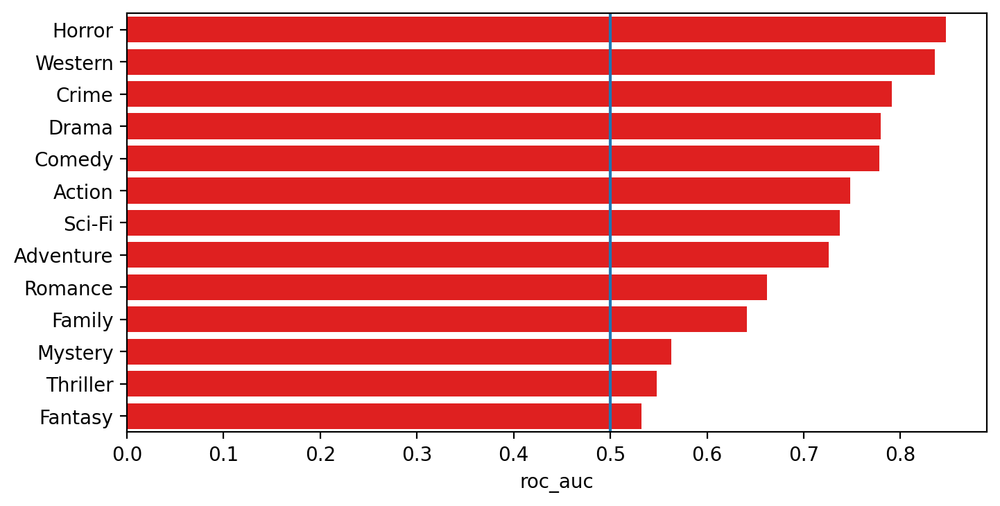

In [57]:
plt.figure(figsize=(8, 4), dpi=200)
ax = sns.barplot(data=metric_df, y='genres', x='roc_auc', color='red')
ax.axvline(.5)
ax.set(ylabel=None)
plt.show()

# Model Predictions

In [26]:
import transformers

pred = transformers.pipeline("text-classification", model=model, tokenizer=tokenizer, device=0, return_all_scores=True)

In [28]:
titanic_plot = wiki.loc[wiki['wiki_ID']==52371, 'plot'].values[0]
titanic_plot

' In 1996, treasure hunter Brock Lovett and his team explore the wreck of RMS Titanic, searching for a valuable diamond necklace called the Heart of the Ocean. They recover Caledon "Cal" Hockley\'s safe, believing the necklace to be inside, but instead find a sketch of a nude woman wearing it, dated April 14, 1912, the night the Titanic sank. Hearing about the drawing, an elderly woman named Rose Dawson Calvert calls Lovett and claims that she is the woman depicted in the drawing. She and her granddaughter, Lizzy Calvert, visit him and his team on his salvage ship. When asked if she knows the whereabouts of the necklace, Rose recalls her time aboard the Titanic, revealing that she is Rose DeWitt Bukater, a passenger believed to have died in the sinking. She then begins her story as follows: In 1912, 17-year-old first class passenger Rose boards "Titanic" in Southampton with her fiancé Cal and her mother Ruth DeWitt Bukater. Ruth stresses the importance of Rose\'s engagement, as the mar

In [29]:
def show_preds(pred, txt):
    preds = pred(txt)
    pred_df = {'label': [], 
               'score': []}
    for p in preds[0]:
        pred_df['label'].append(genres_i[int(p['label'].split('_')[-1])])
        pred_df['score'].append(p['score'])
    pred_df = pd.DataFrame(pred_df).sort_values('score', ascending=False)
    return pred_df

In [36]:
show_preds(pred, titanic_plot[:2300])

,label,score
6,Drama,0.964766
5,Romance,0.654220
10,Adventure,0.154978
3,Thriller,0.128037
8,Fantasy,0.078954
11,Mystery,0.075082
0,Action,0.042420
12,Western,0.037489
4,Comedy,0.036801
9,Crime,0.034180


In [37]:
silence_of_the_lambs_plot = wiki.loc[wiki['wiki_ID']==30006, 'plot'].values[0]
show_preds(pred, silence_of_the_lambs_plot[:2300])

,label,score
9,Crime,0.685989
3,Thriller,0.673600
1,Horror,0.443131
11,Mystery,0.440539
6,Drama,0.391336
0,Action,0.173967
2,Sci-Fi,0.048146
4,Comedy,0.045999
10,Adventure,0.025061
8,Fantasy,0.024382


In [40]:
avatar_plot = wiki.loc[wiki['wiki_ID']==4273140, 'plot'].values[0]
show_preds(pred, avatar_plot[:2100])

,label,score
10,Adventure,0.860674
0,Action,0.859636
2,Sci-Fi,0.299966
6,Drama,0.269571
8,Fantasy,0.229516
7,Family,0.128857
3,Thriller,0.115247
1,Horror,0.064956
12,Western,0.054691
5,Romance,0.042820


In [58]:
good_bad_ugly_plot = wiki.loc[wiki['wiki_ID']==31557, 'plot'].values[0]
show_preds(pred, good_bad_ugly_plot[:2300]) 

,label,score
12,Western,0.717081
6,Drama,0.296530
0,Action,0.261433
10,Adventure,0.206078
4,Comedy,0.187752
5,Romance,0.158334
9,Crime,0.110685
3,Thriller,0.064743
7,Family,0.052072
1,Horror,0.045638


## Model Explanations

In [ ]:
# !pip install shap

In [66]:
import shap

#Creaing an explainer that wraps around our pipeline
explainer = shap.Explainer(pred)

#Estimating SHAP values for our example
shap_values = explainer([titanic_plot[:2300]])
shap_values.output_names = genres_i

shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [67]:
shap_values = explainer([avatar_plot[:2100]])
shap_values.output_names = genres_i
shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [68]:
shap_values = explainer([silence_of_the_lambs_plot[:2300]])
shap_values.output_names = genres_i
shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [69]:
shap_values = explainer([good_bad_ugly_plot[:2100]])
shap_values.output_names = genres_i
shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [71]:
#Creaing an explainer that wraps around our pipeline
explainer = shap.Explainer(pred)

made_up_horror_plot = 'A lovely couple is lost in the woods, trying to escape from zombies.'
made_up_comedy_plot = 'A lovely couple is lost in the woods, trying to escape from their wedding.'


#Estimating SHAP values for our example
shap_values = explainer([made_up_horror_plot, made_up_comedy_plot])
shap_values.output_names = genres_i

shap.plots.text(shap_values)

In [81]:
parasite_plot = '''
The Kim family—father Ki-taek, mother Chung-sook, daughter Ki-jung, and son Ki-woo—live in a small semi-basement apartment (banjiha) in Seoul, have low-paying temporary jobs folding pizza boxes, and struggle to make ends meet. University student Min-hyuk, a friend of Ki-woo's, gives the family a scholar's rock meant to promise wealth. Leaving to study abroad and knowing his friend needs the income, he suggests that Ki-woo pose as a university student to take over his job as an English tutor for the daughter of the wealthy Park family, Da-hye. Ki-woo, pretending to be a Yonsei University student, is subsequently hired by the Parks. The Kim family schemes to get each member of the family a job by posing as unrelated and highly qualified workers to become servants of the Parks. Ki-jung poses as "Jessica" and, using Ki-Woo as a reference, becomes an art therapist to the Parks' young son, Da-song. Ki-jung frames Yoon, Mr Park's chauffeur, by making it appear as if he had sex in the car, then recommends Ki-taek to replace him. Finally, Chung-sook takes over as the Parks' housekeeper after the Kims exploit the peach allergy of the long-time housekeeper, Moon-gwang, to convince Mrs Park that she has tuberculosis. Ki-woo begins a secret romantic relationship with Da-hye. When the Parks leave on a camping trip, the Kims revel in the luxuries of the residence before Moon-gwang abruptly appears at the door, telling Chung-sook she left something in the basement. She enters a hidden entrance to an underground bunker created by the architect and previous homeowner, where Moon-gwang's husband, Geun-sae, has been secretly living for over four years, hiding from loan sharks. Chung-sook refuses Moon-gwang's pleas to help Geun-sae remain in the bunker, but the eavesdropping Kims accidentally reveal themselves. Moon-gwang films them on her phone and threatens to expose their ruse to the Parks. A severe rainstorm brings the Parks home early, and the Kims scramble to clean up the home and subdue Moon-gwang and Geun-sae before they return. The Kims trap Geun-sae and Moon-gwang in the bunker. Mrs Park reveals to Chung-sook that Da-song had a seizure-inducing traumatic experience on a previous birthday, when he saw a "ghost" — actually Geun-sae — emerging from the basement at night. Before the Kims manage to sneak out of the house, they hear Mr Park's off-handed comments about Ki-taek's smell. The Kims find their apartment flooded with sewer water as a result of the severe rainstorm and are forced to shelter in a gymnasium with other displaced people. The next day, Mrs Park hosts a house party for Da-song's birthday with the Kim family's help. Ki-woo enters the bunker with the scholar's rock to find Geun-sae. Finding Moon-gwang has died from a concussion she received during the earlier fight, he is attacked by a deranged Geun-sae, who bludgeons his head with the rock and escapes, leaving Ki-woo lying in a pool of blood at the entrance to the basement. Seeking to avenge Moon-gwang, Geun-sae stabs Ki-jung with a kitchen knife in front of the horrified party guests. Da-song suffers another seizure upon seeing Geun-sae, and a struggle breaks out until Chung-sook fatally impales Geun-sae with a barbecue skewer. While Ki-taek tends to a severely bleeding Ki-jung, Mr Park orders Ki-taek to drive Da-song to the hospital. In the chaos, Ki-taek, upon seeing Mr Park's disgusted reaction to Geun-sae's smell, angrily kills him with the knife. Ki-taek then flees the scene, leaving the rest of the Kim family behind. Weeks later, Ki-woo is recovering from brain surgery. He and Chung-sook are convicted of fraud and put on probation. Ki-jung is revealed to have died from her injuries, and Ki-taek, wanted by the police for Mr Park's murder, cannot be found. Geun-sae has been assumed to be an insane homeless man, and neither his nor Ki-taek's motive for the stabbings are known. Ki-woo spies on the Parks' home, now occupied by a German family unaware of its history, and sees a message in Morse code from a flickering light. Ki-taek, who escaped into the bunker via the garage, has buried Moon-gwang in the backyard and now raids the kitchen at night and sends the message every day, hoping Ki-woo will see it. Still living in their original basement apartment with his mother, Ki-woo writes a letter to Ki-taek, vowing to earn enough money to one day purchase the house and reunite with his father.
'''

shap_values = explainer([parasite_plot[:2000]])
shap_values.output_names = genres_i

shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [83]:
plack_panther_plot = '''
Thousands of years ago, five African tribes war over a meteorite containing the metal vibranium. One warrior ingests a "heart-shaped herb" affected by the metal and gains superhuman abilities, becoming the first "Black Panther". He unites all but the Jabari Tribe to form the nation of Wakanda. Over centuries, the Wakandans use the vibranium to develop advanced technology and isolate themselves from the world by posing as a Third World country. In 1992, Wakanda king T'Chaka visits his brother N'Jobu, who is working undercover in Oakland, California. T'Chaka accuses N'Jobu of assisting black-market arms dealer Ulysses Klaue with stealing vibranium from Wakanda. N'Jobu's partner reveals he is Zuri, another undercover Wakandan, and confirms T'Chaka's suspicions. In the present day, following T'Chaka's death,[N 1] his son T'Challa returns to Wakanda to assume the throne. He and Okoye, the leader of the Dora Milaje regiment, extract T'Challa's ex-lover Nakia from an undercover assignment so she can attend his coronation ceremony with his mother Ramonda and younger sister Shuri. At the ceremony, the Jabari Tribe's leader M'Baku challenges T'Challa for the crown in ritual combat. T'Challa defeats M'Baku and persuades him to yield rather than die. When Klaue and his accomplice Erik Stevens steal a Wakandan artifact from a London museum, T'Challa's friend and Okoye's lover W'Kabi urges him to bring Klaue back alive. T'Challa, Okoye, and Nakia travel to Busan, South Korea, where Klaue plans to sell the artifact to CIA agent Everett K. Ross. A firefight erupts, and Klaue attempts to flee but is caught by T'Challa, who reluctantly releases him to Ross' custody. Klaue tells Ross that Wakanda's international image is a front for a technologically advanced civilization. Erik attacks and extracts Klaue as Ross is gravely injured protecting Nakia. Rather than pursue Klaue, T'Challa takes Ross to Wakanda, where their technology can save him. While Shuri heals Ross, T'Challa confronts Zuri about N'Jobu. Zuri explains that N'Jobu planned to share Wakanda's technology with people of African descent around the world to help them conquer their oppressors. As T'Chaka arrested N'Jobu, the latter attacked Zuri and forced T'Chaka to kill him. T'Chaka ordered Zuri to lie that N'Jobu had disappeared and left behind N'Jobu's American son to maintain the lie. This boy grew up to be Stevens, a black ops U.S. Navy SEAL who adopted the name "Killmonger". Meanwhile, Killmonger kills Klaue and takes his body to Wakanda. He is brought before the tribal elders, revealing his identity to be N'Jadaka and claim to the throne. Killmonger challenges T'Challa to ritual combat, where he kills Zuri, defeats T'Challa, and hurls him over a waterfall to his presumed death. Killmonger ingests the heart-shaped herb and orders the rest incinerated, but Nakia extracts one first. Killmonger, supported by W'Kabi and his army, prepares to distribute shipments of Wakandan weapons to operatives around the world. Nakia, Shuri, Ramonda, and Ross flee to the Jabari Tribe for aid. They find a comatose T'Challa, rescued by the Jabari in repayment for sparing M'Baku's life. Healed by Nakia's herb, T'Challa returns to fight Killmonger, who dons his own nanotech suit, similar to T'Challa's. W'Kabi and his army fight Shuri, Nakia, and the Dora Milaje, while Ross remotely pilots a jet and shoots down planes carrying the vibranium weapons. M'Baku and the Jabari arrive to reinforce T'Challa. Confronted by Okoye, W'Kabi and his army stand down. Fighting in Wakanda's vibranium mine, T'Challa disrupts Killmonger's suit and stabs him. Killmonger refuses to be healed, choosing to die a free man rather than be incarcerated; T'Challa takes him to the waterfall where they fought, where Killmonger dies peacefully. T'Challa establishes an outreach center at the building where N'Jobu died, to be run by Nakia and Shuri. In a mid-credits scene, T'Challa appears before the United Nations to reveal Wakanda's true nature to the world. In a post-credits scene, Shuri helps Bucky Barnes with his recovery.
'''

shap_values = explainer([plack_panther_plot[:2000]])
shap_values.output_names = genres_i

shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [84]:
irishman_plot = '''
In a nursing home, elderly Irish-American World War II veteran Frank Sheeran recounts his time as a hitman for the Mafia. In 1950s Philadelphia, Sheeran works as a union delivery truck driver and starts to sell some of the contents of his shipments to local gangster Skinny Razor, a member of the Philadelphia crime family headed by Angelo Bruno. After the company Sheeran works for accuses him of theft, union lawyer Bill Bufalino gets the case thrown out after Sheeran refuses to name his customers to the judge. Bill introduces Sheeran to his cousin Russell Bufalino, head of the Northeastern Pennsylvania crime family. Sheeran begins to carry out jobs for Russell, as well as members of the South Philadelphia underworld, including "painting houses," a euphemism for contract killing. Soon, Russell introduces Sheeran to Jimmy Hoffa, head of the International Brotherhood of Teamsters, who has financial ties with the Northeastern Pennsylvania crime family and is struggling to deal with fellow rising Teamster Anthony "Tony Pro" Provenzano, in addition to mounting pressure from the federal government. Hoffa becomes close with Sheeran and his family, especially his daughter Peggy, and Sheeran becomes Hoffa's chief bodyguard. After the 1960 election of John F. Kennedy, Russell is thrilled while Hoffa is furious. Kennedy's brother, Robert Kennedy, who he appointed Attorney General, forms a "Get Hoffa" squad to bring down Hoffa, who is eventually arrested and convicted in 1964 for jury tampering. While Hoffa is in prison, his replacement as Teamsters president, Frank "Fitz" Fitzsimmons, misuses the union's pension fund and gives interest-free loans to the Mafia. Hoffa's relationship with Tony Pro, himself arrested for extortion, also deteriorates beyond repair when Hoffa refuses to improve his pension terms. Hoffa has his sentence commuted by President Richard Nixon in 1971, although he is forbidden from partaking in any Teamsters activities until 1980. Despite his parole terms, Hoffa undertakes a plan to reclaim his power atop the Teamsters. Hoffa's growing disrespect for other Teamster leaders and his intention to separate the union from the Mafia begins to worry Russell. During a dinner in Sheeran's honor in October 1973, Russell tells Sheeran to confront Hoffa and warn him that the heads of the crime families are displeased with his behavior. Hoffa then informs Sheeran that he "knows things" that Russell and the dons of other families are unaware of and claims that what he knows makes him untouchable, for if anything ever happened to him, they would all end up in prison. In 1975, while on their way to Bill's daughter's wedding, Russell tells Sheeran that the dons have become fed up with Hoffa and have sanctioned his murder. Reluctantly, Russell informs Sheeran that he has been chosen as the triggerman, knowing he might otherwise try to warn or save Hoffa. The two drive to a private airport where Sheeran boards a plane to Detroit. Hoffa, who had scheduled a meeting at a local restaurant with Tony Pro and Anthony Giacalone, is surprised to see Sheeran arrive late with Hoffa's unsuspecting foster son Chuckie O'Brien and loan shark Sally Bugs. They advise Hoffa that the meeting was moved to a house where Tony Pro and Russell are waiting for them, and drive him over. Entering the house, Hoffa finds it empty and realizes that he has been set up. He turns around to leave, at which point Sheeran shoots him dead at point-blank range before leaving the gun atop his body near the entrance. After Sheeran departs, two other mobsters wrap up the body and cremate it in secret. After taking the Fifth in a grand jury investigation into Hoffa's disappearance, Sheeran, Russell, Tony Pro, and others are eventually convicted on various charges unrelated to Hoffa's murder. One by one, the now elderly gangsters begin to die in prison. Sheeran is eventually released and placed in a nursing home. He tries to reconcile with his alienated daughters, but Peggy, suspecting his involvement in Hoffa's disappearance, severs all contact with him. Sheeran begins seeing a Catholic priest assigned to the nursing home who gives him absolution for crimes he committed over his lifetime. As the priest leaves, Sheeran asks him to leave the door slightly ajar, emulating one of Hoffa's habits.
'''

shap_values = explainer([irishman_plot[:2100]])
shap_values.output_names = genres_i

shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

In [85]:
martian_plot = '''
In 2035, the crew of the Ares III mission to Mars is exploring Acidalia Planitia on Martian solar day (sol) 18 of their 31-sol expedition. A severe dust storm threatens to topple their Mars Ascent Vehicle (MAV). The mission is scrubbed, but as the crew evacuates, astronaut Mark Watney is struck by debris. The telemetry from his suit's bio-monitor is damaged and Watney is erroneously presumed dead. With the MAV (Mars Ascent Vehicle) on the verge of toppling, the remaining crew takes off for their orbiting vessel, the Hermes. Watney awakens after the storm, injured and with a low-oxygen warning. He returns to the crew's surface habitat ("Hab") and treats his wound. As Watney recovers, he begins a video diary. Unable to communicate with Earth, his only chance of rescue is the next Mars mission. In four years, the Ares IV will land 3,200 kilometers (2,000 mi) away at the Schiaparelli crater. Watney's immediate concern is food; being a botanist, he creates a garden inside the Hab using Martian soil fertilized with the crew's bio-waste and manufactures water from leftover rocket fuel. He then cultivates whole potatoes from eyes taken from potatoes in packaged meals. He also begins modifying the rover for the journey to the Ares IV MAV site. On Earth, NASA satellite planner Mindy Park, reviewing satellite images, notices moved equipment and realizes Watney must be alive. NASA director Teddy Sanders releases the news to the public, but decides to not tell the Ares III crew so that they will remain focused on their mission, over flight director Mitch Henderson's strong objection. Watney takes the rover on a one-month journey to retrieve the Pathfinder probe, which fell silent in 1997. Using Pathfinder's camera and motor, he establishes visual contact with NASA. NASA transmits a software patch to link the rover with Pathfinder, enabling communication by text. Sanders finally allows Henderson to inform Watney's crewmates. Mars missions director Vincent Kapoor and Jet Propulsion Laboratory (JPL) director Bruce Ng prepare a space probe to deliver enough food for Watney to survive until Ares IV's arrival. However, the Hab's airlock blows out, exposing the Hab to the harsh Martian environment; the potato plants all die. Now, to save time, Sanders orders the routine safety inspections be bypassed. His gamble fails, and the Atlas V rocket explodes soon after lift-off. The China National Space Administration has developed a secret booster rocket, the Taiyang Shen (lit. the "Sun God"). The decision is made to use the rocket to resupply Watney. However, JPL astrodynamicist Rich Purnell devises an alternative plan: have the Taiyang Shen rendezvous with and resupply the Hermes, which will then use Earth's gravity to "slingshot" back to Mars two years earlier than Ares IV. Sanders rejects the idea, considering it too risky for the Hermes crew. Henderson surreptitiously sends Purnell's proposal to the crew; they unanimously vote to implement it without seeking NASA approval, disabling NASA's remote controls and making the course change. Sanders is forced to support them publicly, but demands Henderson resign after the Ares III mission is complete. Watney begins the 90-sol journey to Schiaparelli, where the MAV for Ares IV has been pre-positioned. He must use it to rendezvous with the Hermes, but it needs to be lightened considerably. After takeoff, when the MAV runs out of fuel, its velocity relative to the Hermes is too great for Watney to be picked up. Commander Lewis quickly improvises, using an explosive to breach a forward airlock, resulting in air escaping violently and slowing down the Hermes. It is still not enough; using a tethered Manned Maneuvering Unit, Lewis is unable to reach Watney. Watney pierces his pressure suit, using the escaping air to propel himself to Lewis, ending his 543 sols alone on Mars. After returning to Earth, Watney becomes a survival instructor for astronaut candidates. Five years later, as the Ares V is about to launch, those involved in Watney's rescue are seen in their current lives.
'''

shap_values = explainer([martian_plot[:2100]])
shap_values.output_names = genres_i

shap.plots.text(shap_values)

  0%|          | 0/248 [00:00<?, ?it/s]

## Feature Importances

In [89]:
shap_values = explainer(wiki.sample(n=200, random_state=42)['plot'].apply(lambda x: x[:2000]))

  0%|          | 0/248 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   1%|          | 2/200 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   3%|▎         | 6/200 [00:26<08:48,  2.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▎         | 7/200 [00:33<13:45,  4.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▍         | 9/200 [00:41<12:27,  3.91s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 10/200 [00:47<14:57,  4.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▌         | 11/200 [00:53<16:27,  5.23s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▋         | 13/200 [01:03<15:16,  4.90s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   7%|▋         | 14/200 [01:10<16:33,  5.34s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   8%|▊         | 16/200 [01:18<14:12,  4.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 20/200 [01:32<09:53,  3.30s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 21/200 [01:38<11:43,  3.93s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  11%|█         | 22/200 [01:44<13:30,  4.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  12%|█▏        | 24/200 [01:55<14:29,  4.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  12%|█▎        | 25/200 [02:01<15:28,  5.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▎        | 27/200 [02:10<13:23,  4.65s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▍        | 28/200 [02:16<14:50,  5.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▍        | 29/200 [02:22<15:28,  5.43s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▌        | 31/200 [02:32<13:55,  4.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  17%|█▋        | 34/200 [02:46<12:33,  4.54s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  18%|█▊        | 35/200 [02:53<14:03,  5.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  18%|█▊        | 37/200 [03:04<14:27,  5.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 41/200 [03:19<10:12,  3.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  22%|██▏       | 43/200 [03:28<10:44,  4.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  22%|██▏       | 44/200 [03:35<12:21,  4.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  22%|██▎       | 45/200 [03:42<14:08,  5.48s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▎       | 47/200 [03:51<12:43,  4.99s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▍       | 49/200 [04:00<10:57,  4.35s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▌       | 51/200 [04:10<11:08,  4.48s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▌       | 52/200 [04:16<12:26,  5.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  27%|██▋       | 54/200 [04:25<11:14,  4.62s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 60/200 [04:48<08:14,  3.53s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 61/200 [04:54<10:09,  4.39s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  32%|███▏      | 63/200 [05:03<09:23,  4.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  32%|███▏      | 64/200 [05:09<10:46,  4.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  33%|███▎      | 66/200 [05:20<11:32,  5.17s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  34%|███▎      | 67/200 [05:26<11:41,  5.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 70/200 [05:37<08:26,  3.90s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▌      | 71/200 [05:44<10:18,  4.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▋      | 73/200 [05:54<10:42,  5.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  38%|███▊      | 76/200 [06:05<07:49,  3.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 80/200 [06:19<06:22,  3.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▎     | 87/200 [06:42<05:09,  2.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▍     | 88/200 [06:49<07:35,  4.07s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▍     | 89/200 [06:56<09:08,  4.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 90/200 [07:03<10:11,  5.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▌     | 92/200 [07:12<08:43,  4.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▋     | 93/200 [07:18<09:16,  5.20s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  47%|████▋     | 94/200 [07:24<09:54,  5.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  48%|████▊     | 97/200 [07:37<07:53,  4.59s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 101/200 [07:53<06:21,  3.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  51%|█████     | 102/200 [08:00<07:54,  4.84s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  52%|█████▏    | 103/200 [08:07<08:48,  5.44s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  52%|█████▎    | 105/200 [08:15<07:12,  4.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▎    | 107/200 [08:23<06:29,  4.19s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▍    | 108/200 [08:30<07:22,  4.81s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 110/200 [08:39<06:54,  4.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▋    | 113/200 [08:53<06:09,  4.24s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  57%|█████▋    | 114/200 [08:59<06:54,  4.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  57%|█████▊    | 115/200 [09:06<07:51,  5.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  58%|█████▊    | 116/200 [09:12<08:07,  5.80s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  58%|█████▊    | 117/200 [09:18<08:06,  5.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▉    | 118/200 [09:25<08:10,  5.98s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 120/200 [09:34<06:46,  5.08s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  62%|██████▏   | 123/200 [09:50<06:25,  5.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▍   | 128/200 [10:06<03:47,  3.16s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 130/200 [10:17<04:47,  4.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  66%|██████▋   | 133/200 [10:28<04:00,  3.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  67%|██████▋   | 134/200 [10:35<04:53,  4.45s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  69%|██████▉   | 138/200 [10:52<04:15,  4.12s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 140/200 [11:03<04:42,  4.71s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 141/200 [11:10<05:17,  5.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  72%|███████▏  | 144/200 [11:22<03:46,  4.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  72%|███████▎  | 145/200 [11:29<04:32,  4.96s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▎  | 147/200 [11:38<04:11,  4.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▍  | 149/200 [11:47<03:38,  4.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 150/200 [11:52<03:50,  4.62s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▌  | 151/200 [11:59<04:11,  5.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▌  | 152/200 [12:05<04:25,  5.52s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▋  | 153/200 [12:11<04:22,  5.58s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  78%|███████▊  | 155/200 [12:22<04:07,  5.49s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  78%|███████▊  | 157/200 [12:34<04:01,  5.62s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▉  | 158/200 [12:41<04:11,  6.00s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|███████▉  | 159/200 [12:47<04:06,  6.02s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 160/200 [12:53<04:04,  6.12s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  82%|████████▏ | 163/200 [13:04<02:34,  4.17s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  82%|████████▏ | 164/200 [13:11<02:55,  4.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  82%|████████▎ | 165/200 [13:17<03:07,  5.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  83%|████████▎ | 166/200 [13:23<03:10,  5.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▍ | 168/200 [13:35<02:57,  5.54s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▍ | 169/200 [13:41<03:00,  5.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 170/200 [13:48<03:02,  6.08s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  86%|████████▌ | 171/200 [13:54<02:58,  6.16s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 180/200 [14:23<01:08,  3.43s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  91%|█████████ | 182/200 [14:33<01:08,  3.83s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  92%|█████████▏| 183/200 [14:40<01:21,  4.81s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  92%|█████████▏| 184/200 [14:46<01:24,  5.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  92%|█████████▎| 185/200 [14:53<01:23,  5.59s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  93%|█████████▎| 186/200 [14:59<01:23,  5.97s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▎| 187/200 [15:06<01:21,  6.25s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▍| 188/200 [15:13<01:15,  6.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▍| 189/200 [15:20<01:11,  6.53s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 190/200 [15:26<01:03,  6.35s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▌| 192/200 [15:35<00:42,  5.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▋| 193/200 [15:41<00:39,  5.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  97%|█████████▋| 194/200 [15:47<00:34,  5.76s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  98%|█████████▊| 195/200 [15:54<00:29,  5.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▉| 198/200 [16:04<00:08,  4.02s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|█████████▉| 199/200 [16:10<00:04,  4.58s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 200/200 [16:17<00:00,  5.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 201it [16:24,  4.95s/it]


### Action ###


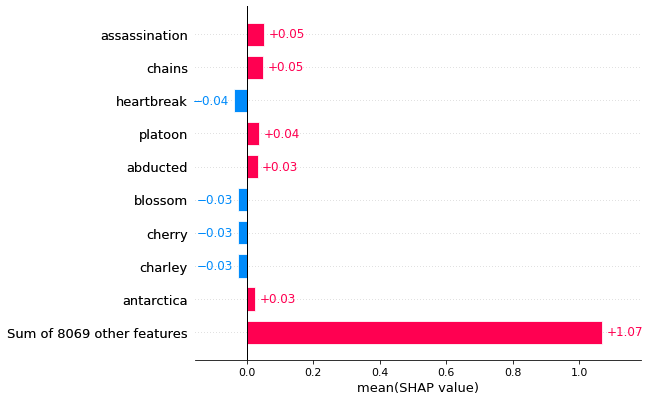

### Horror ###


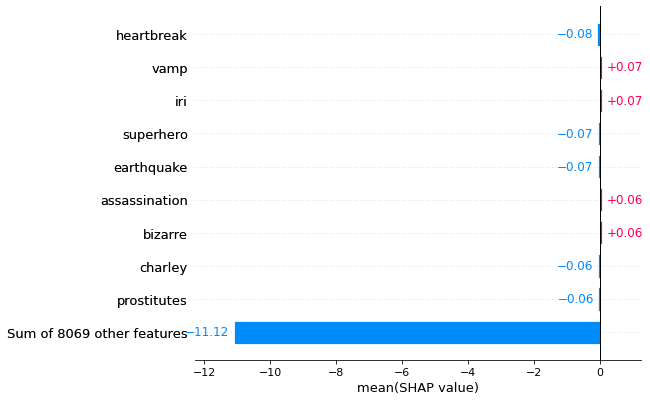

### Sci-Fi ###


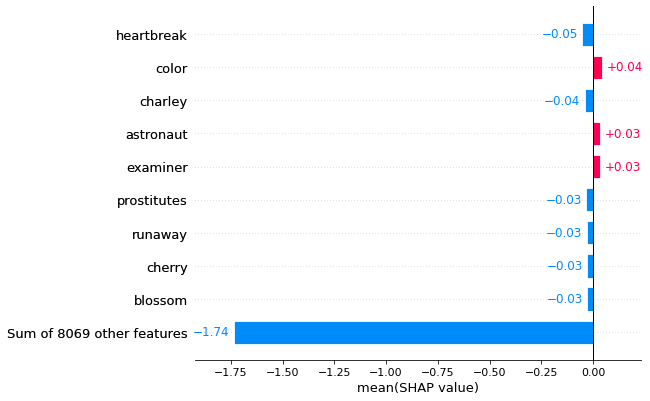

### Thriller ###


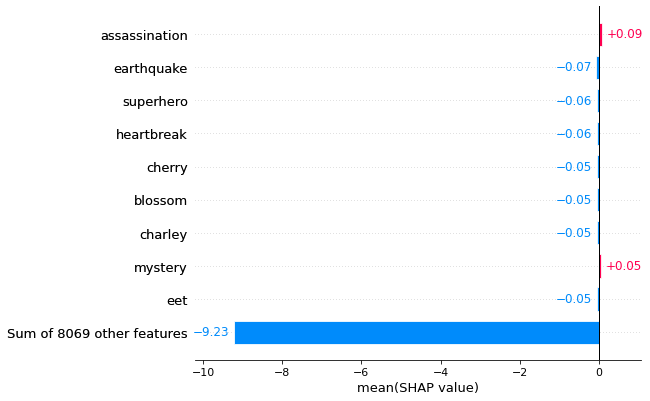

### Comedy ###


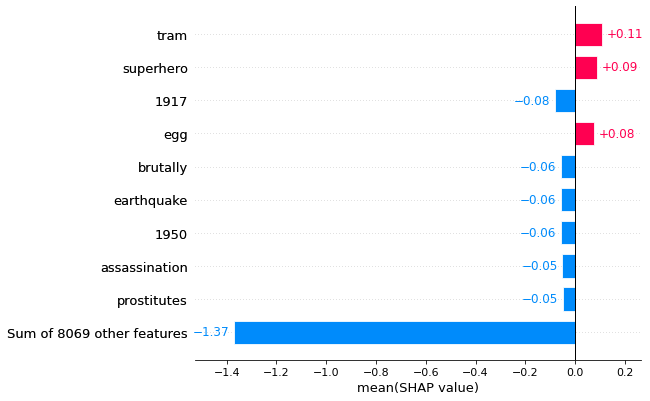

### Romance ###


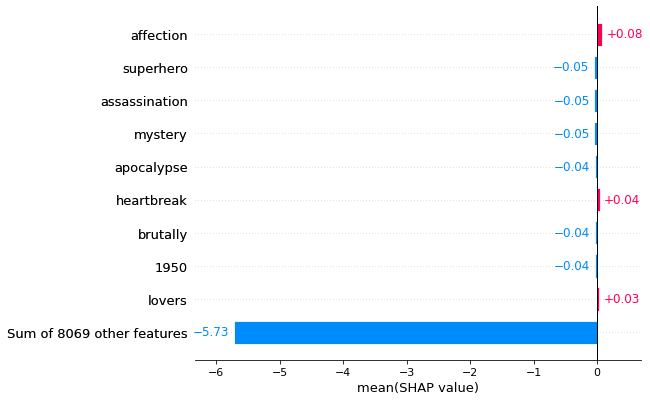

### Drama ###


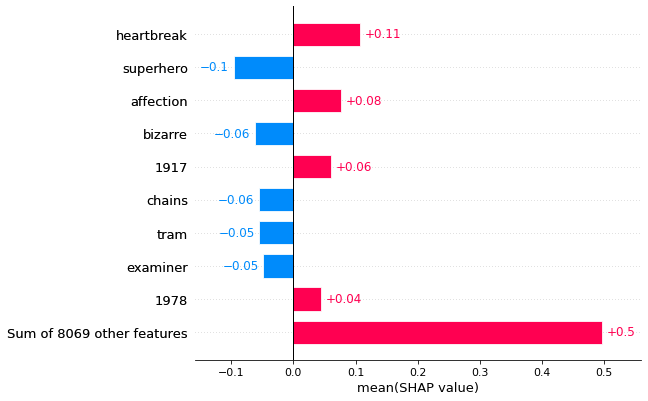

### Family ###


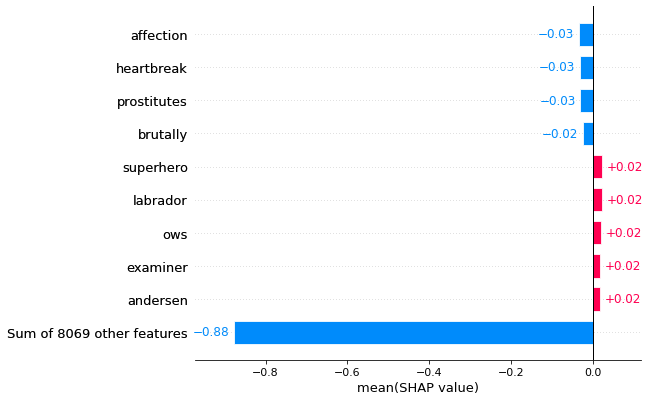

### Fantasy ###


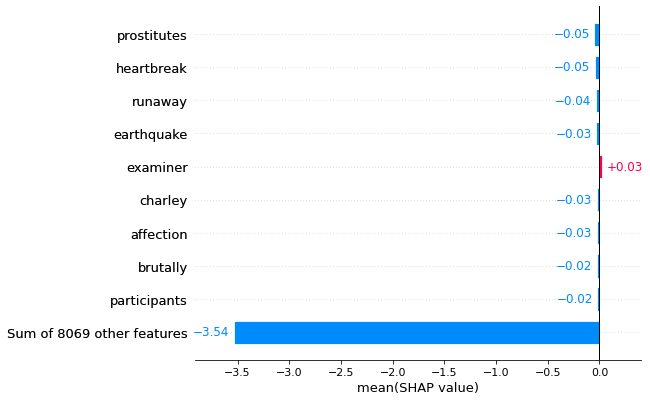

### Crime ###


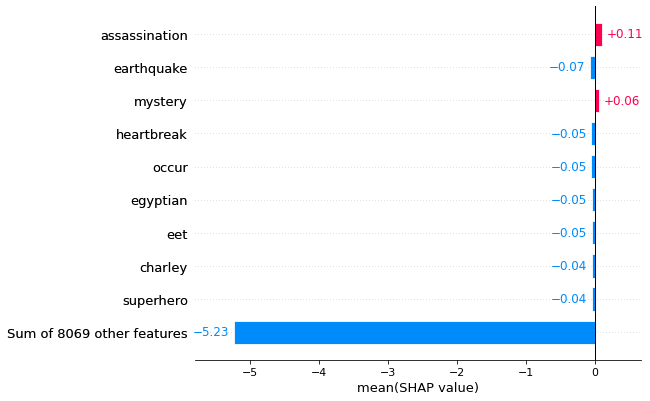

### Adventure ###


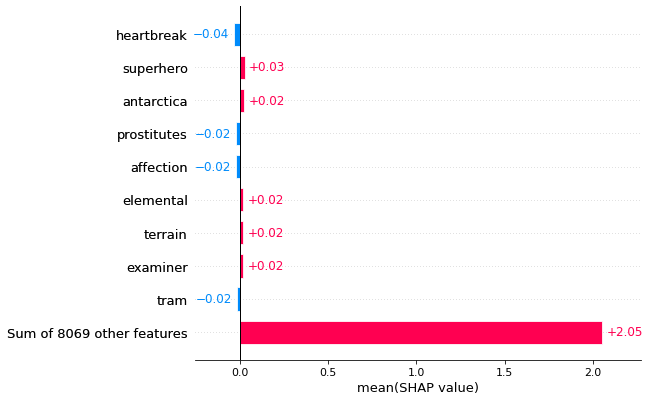

### Mystery ###


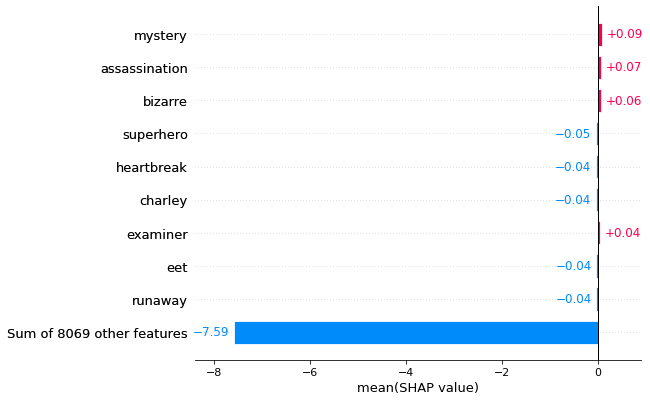

### Western ###


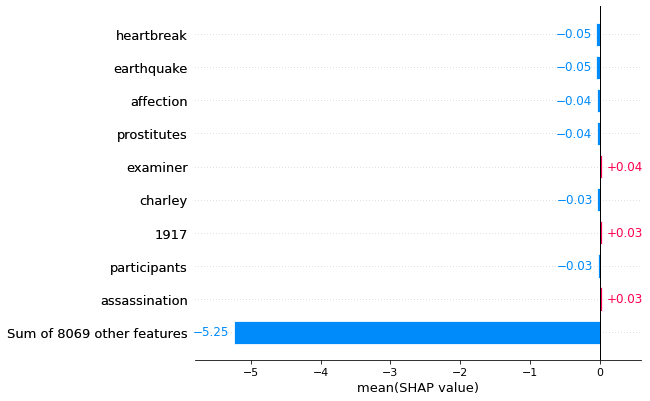

In [90]:
for i, genre in enumerate(genres_i): 
    print("###", genre, "###")
    shap.plots.bar(shap_values[:,:,f"LABEL_{i}"].mean(0))

# Summarization of Movie Plots

In [91]:
summarizer = transformers.pipeline("summarization")

No model was supplied, defaulted to sshleifer/distilbart-cnn-12-6 (https://huggingface.co/sshleifer/distilbart-cnn-12-6)


Downloading:   0%|          | 0.00/1.76k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.14G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/878k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/446k [00:00<?, ?B/s]

In [92]:
summarizer(titanic_plot[:4500], max_length=130, min_length=30, do_sample=False)[0]['summary_text']

' In 1996, treasure hunter Brock Lovett and his team explore the wreck of RMS Titanic, searching for a valuable diamond necklace called the Heart of the Ocean . They find a sketch of a nude woman wearing the necklace dated April 14, 1912, the night the Titanic sank . An elderly woman claims she is Rose DeWitt Bukater, a passenger believed to have died in the sinking .'

In [93]:
summarizer(avatar_plot[:4500], max_length=130, min_length=30, do_sample=False)[0]['summary_text']

" By 2154, humans have severely depleted Earth's natural resources . The Resources Development Administration mines for a valuable mineral on Pandora, a densely forested habitable moon orbiting the gas giant Polyphemus in the Alpha Centauri star system . Pandora is inhabited by the Na'vi, whose atmosphere is poisonous to humans, and Jake and Grace are taken captive . Jake is transferred permanently into his avatar with the aid of the Tree of Souls ."

In [94]:
summarizer(silence_of_the_lambs_plot[:4500], max_length=130, min_length=30, do_sample=False)[0]['summary_text']

' Clarice Starling is pulled from her training at the FBI Academy at Quantico, Virginia, by Jack Crawford of the Behavioral Science Unit . He tasks her with interviewing Hannibal Lecter for help in the pursuit of a serial killer nicknamed "Buffalo Bill" Starling offers Lecter a deal promising a prison transfer if he provides information that helps find Buffalo Bill and rescue the abductee . Instead, Lecter begins a game of quid pro quo with Starling, offering comprehensive clues and insights about Buffalo Bill .'

In [95]:
summarizer(good_bad_ugly_plot[:4600], max_length=60, min_length=30, do_sample=False)[0]['summary_text']

" In a desolate ghost town during the American Civil War, bandit Tuco Ramirez narrowly shoots his way past three bounty hunters to freedom, killing two but only badly wounding the third . During Tuco's flight across the desert he runs into a group of bounty hunters who prepare to capture him"